
# Linear Regression with Python

** This is mostly just code for reference. Please watch the video lecture for more info behind all of this code.**

Your neighbor is a real estate agent and wants some help predicting housing prices for regions in the USA. It would be great if you could somehow create a model for her that allows her to put in a few features of a house and returns back an estimate of what the house would sell for.

Your neighbor then gives you some information about a bunch of houses in regions of the United States,it is all in the data set: USA_Housing.csv.

The data contains the following columns:

* 'Avg. Area Income': Avg. Income of residents of the city house is located in.
* 'Avg. Area House Age': Avg Age of Houses in same city
* 'Avg. Area Number of Rooms': Avg Number of Rooms for Houses in same city
* 'Avg. Area Number of Bedrooms': Avg Number of Bedrooms for Houses in same city
* 'Area Population': Population of city house is located in
* 'Price': Price that the house sold at
* 'Address': Address for the house

**Let's get started!**
## Check out the data
We've been able to get some data from your neighbor for housing prices as a csv set, let's get our environment ready with the libraries we'll need and then import the data!
### Import Libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px


### Check out the Data

In [ ]:
# info, describe, columns

In [2]:
df = pd.read_csv('USA_Housing.csv')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
 6   Address                       5000 non-null   object 
dtypes: float64(6), object(1)
memory usage: 273.6+ KB


In [4]:
df.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386


# EDA

Let's create some simple plots to check out the data!

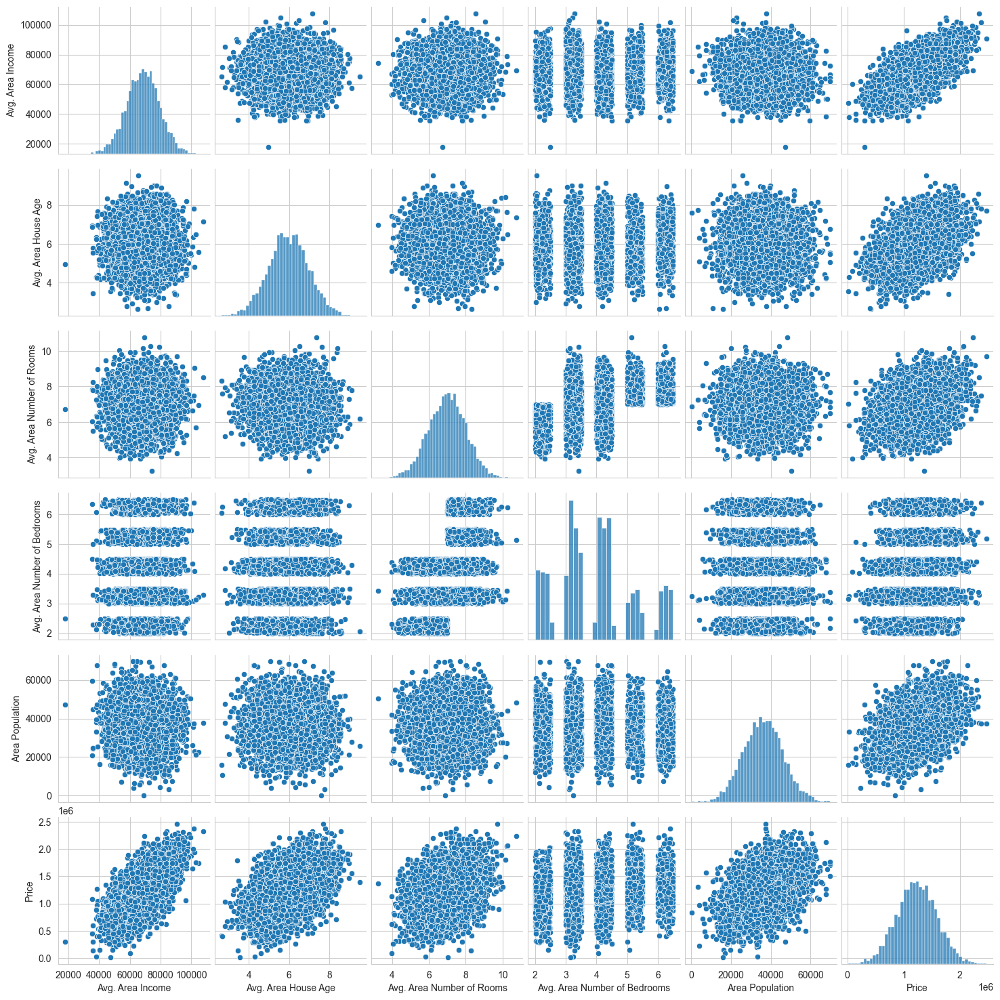

In [5]:
# pairplot

sns.pairplot(df)

In [9]:
# histogram of prices

px.histogram(data_frame=df, x='Price', nbins=30)

<Axes: >

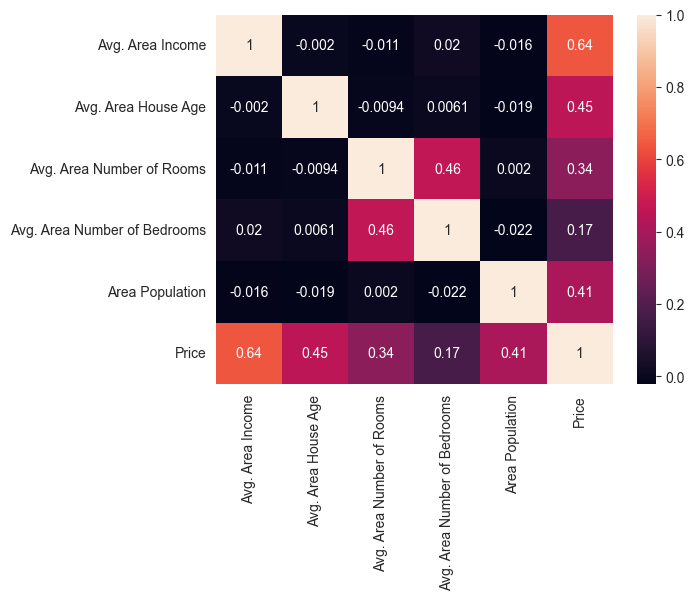

In [6]:
# heatmap of corr
sns.heatmap(df.corr(numeric_only=True), annot=True)

## Training a Linear Regression Model

Let's now begin to train out regression model! We will need to first split up our data into an X array that contains the features to train on, and a y array with the target variable, in this case the Price column. We will toss out the Address column because it only has text info that the linear regression model can't use.

### X and y arrays

In [7]:
# data cleaning
df.drop('Address', axis=1, inplace=True)


In [8]:
df.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05


In [9]:
# attributes:  X

X = df.drop('Price', axis=1 )
y = df['Price']

In [15]:
X

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4.09,23086.800503
1,79248.642455,6.002900,6.730821,3.09,40173.072174
2,61287.067179,5.865890,8.512727,5.13,36882.159400
3,63345.240046,7.188236,5.586729,3.26,34310.242831
4,59982.197226,5.040555,7.839388,4.23,26354.109472
...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035
4996,78491.275435,6.999135,6.576763,4.02,25616.115489
4997,63390.686886,7.250591,4.805081,2.13,33266.145490
4998,68001.331235,5.534388,7.130144,5.44,42625.620156


In [16]:
y

0       1.059034e+06
1       1.505891e+06
2       1.058988e+06
3       1.260617e+06
4       6.309435e+05
            ...     
4995    1.060194e+06
4996    1.482618e+06
4997    1.030730e+06
4998    1.198657e+06
4999    1.298950e+06
Name: Price, Length: 5000, dtype: float64

## Train Test Split

Now let's split the data into a training set and a testing set. We will train out model on the training set and then use the test set to evaluate the model.

In [10]:
from sklearn.model_selection import train_test_split

In [12]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [13]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1650 entries, 1501 to 2873
Data columns (total 5 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              1650 non-null   float64
 1   Avg. Area House Age           1650 non-null   float64
 2   Avg. Area Number of Rooms     1650 non-null   float64
 3   Avg. Area Number of Bedrooms  1650 non-null   float64
 4   Area Population               1650 non-null   float64
dtypes: float64(5)
memory usage: 77.3 KB


## Creating and Training the Model

In [14]:
from sklearn.linear_model import LinearRegression

In [15]:
# create lr

lr = LinearRegression()

In [16]:
# fit training data

lr.fit(X_train, y_train)

LinearRegression()

In [19]:
new_data = X_test.head(1)

In [20]:
lr.predict(new_data)

array([1310035.96931558])

In [21]:
new_data

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
1501,61907.593345,7.017838,6.440256,3.25,43828.947207


In [24]:
y_test.loc[1501] - lr.predict(new_data)

array([29060.10792956])

In [25]:
predicted = lr.predict(X_test)

In [26]:
predicted

array([1310035.96931558, 1238811.85458523, 1245265.83079157, ...,
       1024496.94962135, 1548581.80349705, 1032639.16178958],
      shape=(1650,))

In [27]:
px.histogram(y_test - predicted, nbins=20)

In [31]:
px.line(predicted)

In [34]:
px.histogram(predicted-y_test)

In [37]:
import plotly.graph_objects as go

fig = go.Figure()

fig = px.scatter(x=predicted, y=y_test)

fig.add_trace(go.Scatter(x=[min_val, max_val] , y = [min_val,max_val]))

fig.show()

In [35]:
min_val = min(min(predicted), min(y_test))
max_val = max(max(predicted), max(y_test))




In [33]:
actual_pred = pd.DataFrame()

actual_pred['Predicted'] = predicted
actual_pred['Actual'] = y_test

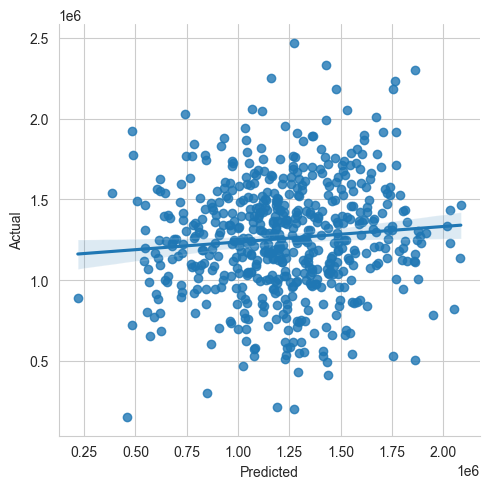

In [34]:
sns.lmplot(data=actual_pred ,x='Predicted' ,y='Actual')

## Model Evaluation

Let's evaluate the model by checking out it's coefficients and how we can interpret them.

In [39]:
predicted = lr.predict(X_test)
actual_values = y_test


In [40]:
# print the intercept

lr.intercept_

np.float64(-2638142.110428784)

In [43]:
# dataframe of lm coef_ and X.columns

lr.coef_

pd.DataFrame(lr.coef_, index=X.columns)

,0
Avg. Area Income,21.589887
Avg. Area House Age,166102.501246
Avg. Area Number of Rooms,119895.936402
Avg. Area Number of Bedrooms,1901.071012
Area Population,15.231503


## Predictions from our Model

Let's grab predictions off our test set and see how well it did!

In [ ]:
# lm.predict(X_test)

In [ ]:
# scatter of y_test and predictions

**Residual Histogram**

## Regression Evaluation Metrics


Here are three common evaluation metrics for regression problems:

**Mean Absolute Error** (MAE) is the mean of the absolute value of the errors:

$$\frac 1n\sum_{i=1}^n|y_i-\hat{y}_i|$$

**Mean Squared Error** (MSE) is the mean of the squared errors:

$$\frac 1n\sum_{i=1}^n(y_i-\hat{y}_i)^2$$

**Root Mean Squared Error** (RMSE) is the square root of the mean of the squared errors:

$$\sqrt{\frac 1n\sum_{i=1}^n(y_i-\hat{y}_i)^2}$$

Comparing these metrics:

- **MAE** is the easiest to understand, because it's the average error.
- **MSE** is more popular than MAE, because MSE "punishes" larger errors, which tends to be useful in the real world.
- **RMSE** is even more popular than MSE, because RMSE is interpretable in the "y" units.

All of these are **loss functions**, because we want to minimize them.

In [45]:
from sklearn import metrics

metrics.mean_absolute_error(actual_values, predicted)

80893.81190769987

In [46]:
metrics.mean_squared_error(actual_values,predicted)

10013679978.582382

In [47]:
metrics.root_mean_squared_error(actual_values,predicted)

100068.3765161721

This was your first real Machine Learning Project! Congrats on helping your neighbor out! We'll let this end here for now, but go ahead and explore the Boston Dataset mentioned earlier if this particular data set was interesting to you!

## Great Job!

In [49]:
metrics.r2_score(actual_values,predicted)

0.9165334724138312

In [50]:
X.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4.09,23086.800503
1,79248.642455,6.002900,6.730821,3.09,40173.072174
2,61287.067179,5.865890,8.512727,5.13,36882.159400
3,63345.240046,7.188236,5.586729,3.26,34310.242831
4,59982.197226,5.040555,7.839388,4.23,26354.109472


In [52]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

X_scaled = scaler.fit_transform(X)

In [53]:
X_scaled

array([[ 1.02865969, -0.29692705,  0.02127433,  0.08806222, -1.31759867],
       [ 1.00080775,  0.02590164, -0.25550611, -0.72230146,  0.40399945],
       [-0.68462916, -0.11230283,  1.5162435 ,  0.93084045,  0.07240989],
       ...,
       [-0.48723454,  1.28447022, -2.17026949, -1.50025059, -0.29193658],
       [-0.05459152, -0.44669439,  0.14154061,  1.18205319,  0.65111608],
       [-0.28831272,  0.01521477, -0.19434166,  0.07185495,  1.04162464]],
      shape=(5000, 5))

In [62]:
X_train, X_test, y_train, y_test = train_test_split( X_scaled, y, test_size=0.33)

In [63]:
lr = LinearRegression()

lr.fit(X_train, y_train)

LinearRegression()

In [64]:
predicted = lr.predict(X_test)

In [65]:
metrics.mean_squared_error(y_test, predicted)

10356546644.69466

In [66]:
metrics.mean_absolute_error(y_test, predicted)

81770.19677293573

In [67]:
predicted

array([1031525.04574328, 1222828.38326614, 1854999.40670183, ...,
       1075132.30404478, 1891644.03064684, 1093953.73818444],
      shape=(1650,))

In [61]:
metrics.r2_score(y_test,predicted)

0.9165334724138281

In [68]:
from sklearn.model_selection import cross_val_score

In [70]:
cross_val_score(lr, X_scaled, y, cv = 5).mean()

np.float64(0.9175592097606909)

In [76]:
(-1)*cross_val_score(lr, X_scaled, y, cv = 5, scoring='neg_mean_absolute_error').mean()

np.float64(81470.92049124547)

In [77]:
y.mean()

np.float64(1232072.654142357)

In [78]:
cross_val_score(lr, X_scaled, y, cv = 10).mean()

np.float64(0.9173792621537308)

In [79]:
(-1)*cross_val_score(lr, X_scaled, y, cv = 10, scoring='neg_mean_absolute_error').mean()

np.float64(81427.89617840709)